# Project El Niño-Southern Oscillation (ENSO)

A ’toy’ model of the ENSO wave oscillator is the delay equation for the spatially
averaged eastern Pacific temperature
$$\frac{dT(t)}{dt} = a T (t) − b T (t − d) − c T^3 (t) \label{eq:dim_enso} \tag{1}$$
Here $a$ represents the growth rate of the temperature disturbance $T$ in the eastern Pacific.
The quantity $d$ is the delay time due to the propagation of equatorial waves, and $b$ measures
its influence with respect to the local feedbacks. The nonlinear term with coefficient $c$ is
needed for equilibration of the temperature to finite amplitude.


## Exercises (and solutions)

*Preambula:*

In [1]:
import matplotlib.pyplot as plt
import numpy as np
from matplotlib import rc
rc('font',**{'family':'serif','sans-serif':['Times'],'size':16})


### *(i)* Apply a scaling in temperature and time to derive the equation
$$\frac{dT(t)}{dt} = T (t) − \alpha T (t − \delta) − T^3 (t) \label{eq:nondim_enso} \tag{2}$$
with $\alpha = b/a$ and $\delta = a d$.

***Solution:***

$a$ and $b$ are the inverse of a time, their SI units are thus in $\mathrm{s}^{-1}$, while the time $t$ and the delay $d$ are in $\mathrm{s}$. On the other hand, $T$ is in Kelvin, which means that $c$ is in $\mathrm{K}^{-2} \, \mathrm{s}^{-1}$. We want to set the nondimensional growth rate of the disturbance to 1, and for that we need $a$, so the proper scaling for $T$ is obtained using both $a$ and (obviously) $c$, and the only way to obtain a temperature rescaling is thus to rescale according to $T =  T' \sqrt{\frac{a}{c}}$, with $T'$ being nondimensional. This leads to
$$\frac{dT'(t)}{dt} = a T' (t) − b T' (t − \delta) − a T'^3 (t) \label{eq:1st_nondim_enso} \tag{2'}$$
Now we can rescale the time according to $t = t' / a$ with $t'$ being the nondimensional time. We thus need to rescale the delay $d$ as well : $d= \delta/a$. Replacing in [(2')](#mjx-eqn-eq:1st_nondim_enso), we get thus the result
$$\frac{dT'(t')}{dt'} = T' (t') − \alpha T' (t' − \delta) − T'^3 (t') = f (T'(t'),T'(t'-\delta)) \label{eq:nondim_enso_final} \tag{2''}$$
which is indeed equivalent to [(2)](#mjx-eqn-eq:nondim_enso).

### *(ii)* Determine (analytically) the fixed points (steady states) of this model.


***Solution:***

In a steady state, the delay $\delta$ do not play a role, and therefore the steady states are given by the root $\bar T$ of the equation
$$\dot{\bar{T}} = \bar T − \alpha \bar T − \bar{T}^3 = 0 \label{eq:sts} \tag{sts}$$

The 3 steady states are thus:
$\bar T = 0$ and $\bar T = \pm \sqrt{1 - \alpha}$

### *(iii)* Consider the stability of the fixed points in both regimes α < 1 and α > 1. Which regime is more realistic for ENSO dynamics (and why)?


***Solution:***


To study their stability, we need to develop a perturbation approach to take care of the delay. Let's set $T' = \bar T + \Delta T$, then, we get
$$\partial_{t'} \Delta T = \Delta T (t') \left. \frac{\partial f}{\partial T'(t')} \right|_{\bar T} + \Delta T(t'-\delta) \left. \frac{\partial f}{\partial T'(t'-\delta)} \right|_{\bar T} = \Delta T(t')\, (1-3 \bar T^2) - \alpha\, \Delta T(t'-\delta)  \label{eq:lin} \tag{lin}$$
and this perturbation equation can be studied with perturbation of the form $\Delta T = e^{\sigma t'}$ with $\sigma = \sigma_r + i \sigma_i$ being complex. Plugging this solution into the equation above, one gets:
$$\sigma = (1-3 \bar T^2) - \alpha e^{-\delta \sigma}$$
which in complex form gives:
$$\sigma_r = (1-3 \bar T^2) - \alpha\, e^{-\delta \sigma_r} \, \cos(\sigma_i \delta)$$
$$\sigma_i = \alpha\, e^{-\delta \sigma_r}\, \sin(\sigma_i \delta)$$
These equations define a curve called the *neutral* curve separating the stable from the unstable perturbation. This curve is the solution of the equation above for $\sigma_r = 0$, indeed if $\sigma_r > 0$  we obtain stable (decaying) perturbations, while with $\sigma_r < 0$ we have unstable (exploding) solutions. The case $\sigma_r = 0$ is thus the neutral case.
This neutral curve is thus defined by:
$$\delta = \frac{1}{\sigma_i} \left(\arccos \left(\frac{1-3 \bar T^2}{\alpha}\right)\right)$$
$$\sigma_i = |\sigma| = \sqrt{\alpha^2 - (1-3 \bar T^2)^2}$$
These curves are plotted below:

In [2]:
def sigma_i(alpha, Tbar):
    """Function to compute the imaginary part of sigma on the neutral curve.
    
    Parameters
    ----------
    alpha: float
        The alpha parameter of the model (2'').
    Tbar: float
        The steady-state considered.
    
    Returns
    -------
    float:
        The value of the imaginary part of sigma.
    """
    return np.sqrt(alpha**2 - (1-3*Tbar**2)**2)

def delta(alpha, Tbar):
    """Function to compute the value of the delay delta on the neutral curve.
    
    Parameters
    ----------
    alpha: float
        The alpha parameter of the model (2'').
    Tbar: float
        The steady-state considered.
    
    Returns
    -------
    float:
        The value of the delay.
    """
    
    return np.arccos((1-3*Tbar**2)/alpha) / sigma_i(alpha, Tbar)

*For $\alpha < 1$ :*

/tmp/ipykernel_141999/3245728501.py:34: RuntimeWarning: invalid value encountered in arccos
  return np.arccos((1-3*Tbar**2)/alpha) / sigma_i(alpha, Tbar)
/tmp/ipykernel_141999/3245728501.py:16: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(alpha**2 - (1-3*Tbar**2)**2)
/tmp/ipykernel_141999/3245728501.py:34: RuntimeWarning: invalid value encountered in arccos
  return np.arccos((1-3*Tbar**2)/alpha) / sigma_i(alpha, Tbar)
/tmp/ipykernel_141999/3245728501.py:16: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(alpha**2 - (1-3*Tbar**2)**2)
/tmp/ipykernel_141999/3245728501.py:34: RuntimeWarning: invalid value encountered in arccos
  return np.arccos((1-3*Tbar**2)/alpha) / sigma_i(alpha, Tbar)
/tmp/ipykernel_141999/3245728501.py:16: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(alpha**2 - (1-3*Tbar**2)**2)
/tmp/ipykernel_141999/3245728501.py:16: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(alpha**2 - (1-3*Tbar

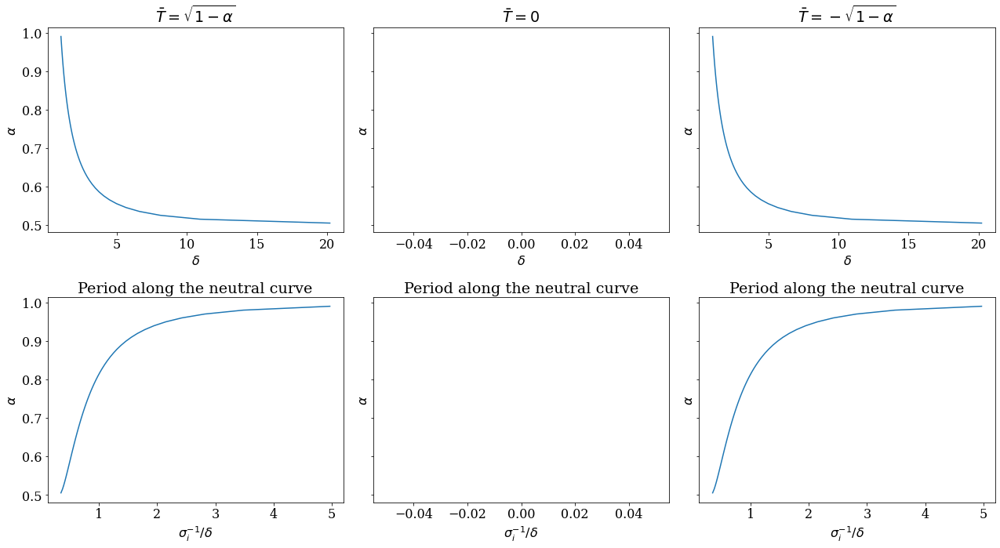

In [3]:
fig, axs = plt.subplots(nrows=2, ncols=3, sharey=True,
                                    figsize=(18, 10), tight_layout=True)

alpha = np.linspace(0.01,0.99,98)

ax = axs[0,0]

ax.set_title(r'$\bar T = \sqrt{1-\alpha}$')
ax.plot(delta(alpha,np.sqrt(1-alpha)), alpha)
ax.set_xlabel(r'$\delta$')
ax.set_ylabel(r'$\alpha$')

ax = axs[0,1]

ax.set_title(r'$\bar T = 0$')
ax.plot(delta(alpha,0), alpha)
ax.set_xlabel(r'$\delta$')
ax.set_ylabel(r'$\alpha$')

ax = axs[0,2]

ax.set_title(r'$\bar T = -\sqrt{1-\alpha}$')
ax.plot(delta(alpha,-np.sqrt(1-alpha)), alpha);
ax.set_xlabel(r'$\delta$')
ax.set_ylabel(r'$\alpha$');

ax = axs[1,0]

ax.set_title(r'Period along the neutral curve')
ax.plot((1/sigma_i(alpha, np.sqrt(1-alpha))) / delta(alpha,np.sqrt(1-alpha)), alpha)
ax.set_xlabel(r'$\sigma_i^{-1} / \delta$')
ax.set_ylabel(r'$\alpha$')

ax = axs[1,1]

ax.set_title(r'Period along the neutral curve')
ax.plot((1/sigma_i(alpha, 0.)) / delta(alpha,0.), alpha)
ax.set_xlabel(r'$\sigma_i^{-1} / \delta$')
ax.set_ylabel(r'$\alpha$')

ax = axs[1,2]

ax.set_title(r'Period along the neutral curve')
ax.plot((1/sigma_i(alpha, -np.sqrt(1-alpha))) / delta(alpha,-np.sqrt(1-alpha)), alpha)
ax.set_xlabel(r'$\sigma_i^{-1} / \delta$')
ax.set_ylabel(r'$\alpha$');



In this case the trivial state $\bar T = 0$ is unstable and the two other states can be either stable or unstable depending on the value of $\delta$ and $\alpha$.

*For $\alpha > 1$ :*

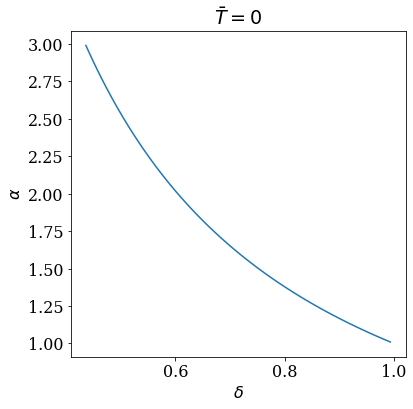

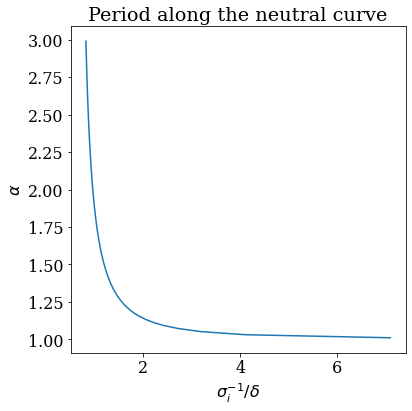

In [4]:
fig = plt.figure(figsize=(6,6))
ax1 = fig.gca()
alpha = np.linspace(1.01,2.99,98)

ax1.set_title(r'$\bar T = 0$')
ax1.plot(delta(alpha,0), alpha)
ax1.set_xlabel(r'$\delta$')
ax1.set_ylabel(r'$\alpha$');

fig = plt.figure(figsize=(6,6))
ax2 = fig.gca()

ax2.set_title(r'Period along the neutral curve')
ax2.plot((1/sigma_i(alpha, 0.)) / delta(alpha,0.), alpha)
ax2.set_xlabel(r'$\sigma_i^{-1} / \delta$')
ax2.set_ylabel(r'$\alpha$');


In this case, only the trivial state exists and it can be either stable or unstable depending on the value of $\delta$ and $\alpha$.

We note that if $\alpha > 1$ then $b > a$ and the feedback is able to generate an oscillation for smaller values of $\delta$, which is why this regime seems more realistic.

### *(iv)* Write a Python program to integrate equation [(2)](#mjx-eqn-eq:nondim_enso). 
Make an appropriate choice for the initial conditions (over the interval $[0, \delta]$ or $[−\delta, 0]$). Provide a check of the code using the analytical results of *(ii)* and *(iii)*.


***Solution:***

We define first a simple Euler integrator for Eq. [(2)](#mjx-eqn-eq:nondim_enso) in the form:

$$\dot x = g(x, x_\delta) \label{eq:x} \tag{xd}$$

where $g$ is an arbitrary function of $x$ and $x_\delta$ which is $x$ delayed by a time $\delta$. Here is the code:

In [5]:
def integrate(func, dt, num_steps, param, ic, lag_step):
    """Integrate the equation (xd) with a simple Euler scheme.
    
    Parameters
    ----------
    func: callable
        The functions g in equation (xd). Should take the two arguments x and x_delta.
    dt: float
        The timestep.
    num_steps: int
        The number of steps to compute and return.
    param: dict
        Additional parameters to pass to the function `func`.
    ic: float
        The initial condition.
    lag_steps: int
        The number of steps to lag the second variable of `func`.
        
    Returns
    -------
    (time, trajectory): array_like
        Times and values of x along a trajectory of equation (xd).
    """
    # creating a registry to store a part of the trajectory
    reg = [ic] * lag_step
    # and lists to store the trajectory
    trajectory = [ic]
    time = [0.]
    # Setting the initial condition
    x = ic
    for i in range(num_steps):
        # Getting the lagged x
        xd = reg.pop()
        # Computing one Euler step 
        xnew = x + func(x, xd, **param) * dt
        # Saving the new state in the registry
        reg.insert(0, xnew)
        x = xnew
        # Saving the new state in the trajectory lists
        trajectory.append(x)
        time.append(time[-1]+dt)

    # Converting lists to numpy arrays on output
    return np.array(time), np.array(trajectory)

and actually define Eq. [(2'')](#mjx-eqn-eq:nondim_enso_final) :

In [6]:
def f(T, Td, alpha=0.):
    """Function f present in equation (2'').
    
    Parameters
    ----------
    T: float
        The (nondimensional) temperature.
    Td: float
        The lagged (nondimensional) temperature.
    alpha: float, optional
        The alpha parameter of the model (2''). Is set to 0 if not provided.
    """
    return T - alpha * Td - T**3


We can also define Eq. [(lin)](#mjx-eqn-eq:lin) :

In [7]:
def f_lin(T, Td, Tbar=0., alpha=0.):
    """Function f present in equation (lin).
    
    Parameters
    ----------
    T: float
        The (nondimensional) temperature.
    Td: float
        The lagged (nondimensional) temperature.
    Tbar: float
        The steady state around which the dynamics is linearized
    alpha: float, optional
        The alpha parameter of the model (2''). Is set to 0 if not provided.
    """
    return T * (1-3*Tbar**2)  - alpha * Td


Now we can check our integrator:

CPU times: user 17.1 ms, sys: 557 µs, total: 17.6 ms
Wall time: 17.1 ms


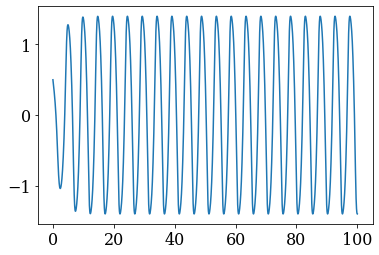

In [8]:
%%time 

time, trajectory = integrate(f, 0.01, 10000, {'alpha': 1.5}, 0.5, 150)

plt.plot(time, trajectory);

**It seems to work and we can now check the result of *(ii)* and *(iii)*:**

*For $\alpha < 1$:*

Let's fix $\alpha$ to 0.6 and set $\delta$ to 2.5 and 5.0:

CPU times: user 52.4 ms, sys: 36.2 ms, total: 88.6 ms
Wall time: 38.4 ms


Text(0, 0.5, "$T'$")

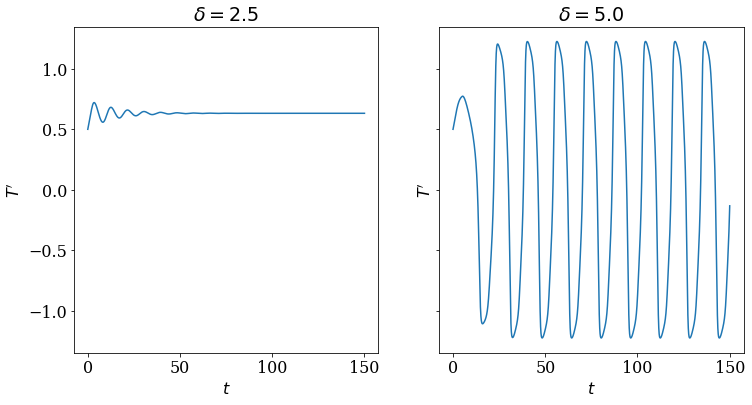

In [9]:
%%time 

# delta = 2.5
time0, trajectory0 = integrate(f, 0.01, 15000, {'alpha': 0.6}, 0.5, 250)

# delta = 5.0
time1, trajectory1 = integrate(f, 0.01, 15000, {'alpha': 0.6}, 0.5, 500)

fig, axs = plt.subplots(nrows=1, ncols=2, sharey=True,
                                    figsize=(12, 6))

ax = axs[0]

ax.set_title(r'$\delta = 2.5$')
ax.plot(time0, trajectory0)
ax.set_xlabel(r'$t$')
ax.set_ylabel(r"$T'$");

ax = axs[1]
ax.set_title(r'$\delta = 5.0$')
ax.plot(time1, trajectory1)
ax.set_xlabel(r'$t$')
ax.set_ylabel(r"$T'$");


and this is coherent with the previous results.

We can also integrate the linearized equation [(lin)](#mjx-eqn-eq:lin) :

CPU times: user 37.8 ms, sys: 832 µs, total: 38.6 ms
Wall time: 37.2 ms


Text(0, 0.5, "$T'$")

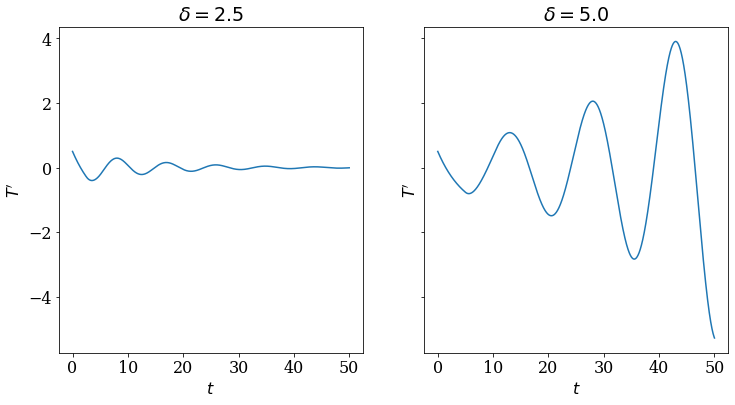

In [10]:
%%time 
alpha = 0.6
Tbar = np.sqrt(1. - alpha)

# delta = 2.5
time0, trajectory0 = integrate(f_lin, 0.01, 5000, {'Tbar': Tbar, 'alpha': alpha}, 0.5, 250)

# delta = 5.0
time1, trajectory1 = integrate(f_lin, 0.01, 5000, {'Tbar': Tbar, 'alpha': alpha}, 0.5, 500)

fig, axs = plt.subplots(nrows=1, ncols=2, sharey=True,
                                    figsize=(12, 6))

ax = axs[0]

ax.set_title(r'$\delta = 2.5$')
ax.plot(time0, trajectory0)
ax.set_xlabel(r'$t$')
ax.set_ylabel(r"$T'$");

ax = axs[1]
ax.set_title(r'$\delta = 5.0$')
ax.plot(time1, trajectory1)
ax.set_xlabel(r'$t$')
ax.set_ylabel(r"$T'$");


*For $\alpha > 1$:*

Let's fix $\alpha$ to 1.5 and set $\delta$ to 0.5 and 0.9:

CPU times: user 42 ms, sys: 0 ns, total: 42 ms
Wall time: 41.5 ms


Text(0, 0.5, "$T'$")

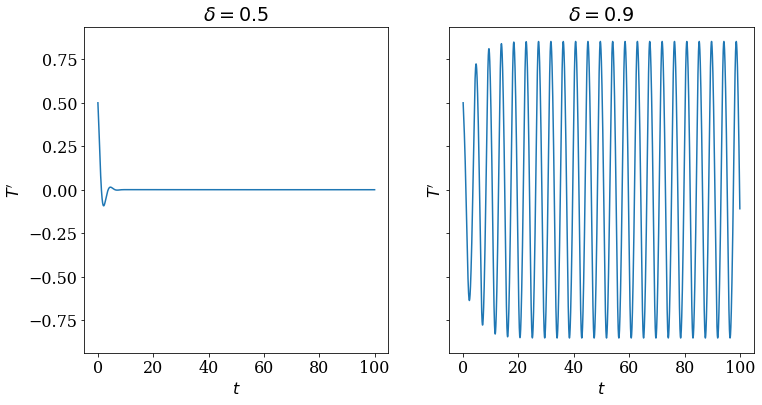

In [11]:
%%time 

# delta = 0.5
time0, trajectory0 = integrate(f, 0.01, 10000, {'alpha': 1.5}, 0.5, 50)

# delta = 0.9
time1, trajectory1 = integrate(f, 0.01, 10000, {'alpha': 1.5}, 0.5, 90)

fig, axs = plt.subplots(nrows=1, ncols=2, sharey=True,
                                    figsize=(12, 6))

ax = axs[0]

ax.set_title(r'$\delta = 0.5$')
ax.plot(time0, trajectory0)
ax.set_xlabel(r'$t$')
ax.set_ylabel(r"$T'$")

ax = axs[1]
ax.set_title(r'$\delta = 0.9$')
ax.plot(time1, trajectory1)
ax.set_xlabel(r'$t$')
ax.set_ylabel(r"$T'$")


and again this is coherent with the previous results.

We can also integrate the linearized equation [(lin)](#mjx-eqn-eq:lin) :

CPU times: user 23.9 ms, sys: 0 ns, total: 23.9 ms
Wall time: 23.6 ms


Text(0, 0.5, "$T'$")

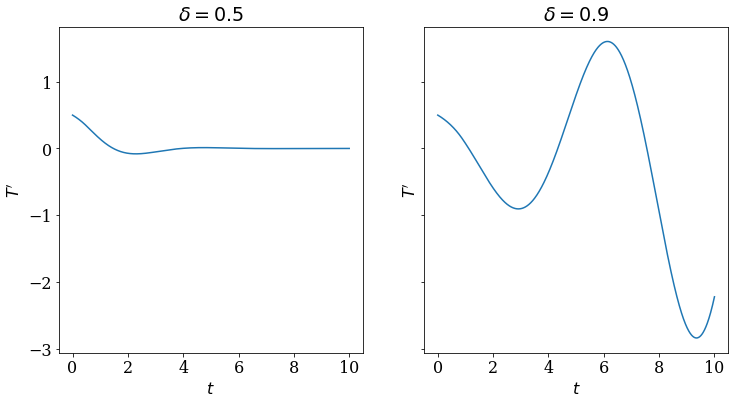

In [12]:
%%time 
alpha = 1.5
Tbar = 0.

# delta = 2.5
time0, trajectory0 = integrate(f_lin, 0.01, 1000, {'Tbar': Tbar, 'alpha': alpha}, 0.5, 50)

# delta = 5.0
time1, trajectory1 = integrate(f_lin, 0.01, 1000, {'Tbar': Tbar, 'alpha': alpha}, 0.5, 90)

fig, axs = plt.subplots(nrows=1, ncols=2, sharey=True,
                                    figsize=(12, 6))

ax = axs[0]

ax.set_title(r'$\delta = 0.5$')
ax.plot(time0, trajectory0)
ax.set_xlabel(r'$t$')
ax.set_ylabel(r"$T'$");

ax = axs[1]
ax.set_title(r'$\delta = 0.9$')
ax.plot(time1, trajectory1)
ax.set_xlabel(r'$t$')
ax.set_ylabel(r"$T'$");


### (v) Explore the solutions of [(2)](#mjx-eqn-eq:nondim_enso) for a range of values of $\delta$ and identify the different dynamical regimes.


***Solution:***

We will now loop on various $\delta$ and $\alpha$.

*For $\alpha < 1$:*

In [13]:
%%time 

dt = 0.01
ic = 0.5
num_steps = 15000
rescale = True

delta_step = range(50,1501,40)
alpha_vec = np.arange(0.1,1.01,0.1)

fig, axs = plt.subplots(nrows=len(delta_step), ncols=len(alpha_vec), figsize=(len(alpha_vec)*6, len(delta_step)*6), sharey=True, tight_layout=True)

for i, ds in enumerate(delta_step):
    for j, a in enumerate(alpha_vec):
        time, trajectory = integrate(f, dt, num_steps, {'alpha': a}, ic, ds)

        ax = axs[i, j]
        
        if rescale:
            dlt = ds * dt
        else:
            dlt = 1.
            
        ax.set_title(r'$\alpha = $'+ str(a)[:4] + ' , ' + r'$\delta = $'+str(dlt)[:4])
        ax.plot(time/dlt, trajectory)
        ax.set_xlabel(r'$t / \delta$')
        ax.set_ylabel(r"$T'$")



CPU times: user 9.62 s, sys: 54.4 ms, total: 9.68 s
Wall time: 9.71 s


*For $\alpha > 1$:*

In [14]:
%%time 

dt = 0.01
ic = 0.5
num_steps = 15000
rescale = True

delta_step = range(50,1501,40)
alpha_vec = np.arange(1.1,2.01,0.1)

fig, axs = plt.subplots(nrows=len(delta_step), ncols=len(alpha_vec), figsize=(len(alpha_vec)*6, len(delta_step)*6), sharey=True, tight_layout=True)

for i, ds in enumerate(delta_step):
    for j, a in enumerate(alpha_vec):
        time, trajectory = integrate(f, dt, num_steps, {'alpha': a}, ic, ds)

        ax = axs[i, j]
        
        if rescale:
            dlt = ds * dt
        else:
            dlt = 1.
            
        ax.set_title(r'$\alpha = $'+ str(a)[:4] + ' , ' + r'$\delta = $'+str(dlt)[:4])
        ax.plot(time/dlt, trajectory)
        ax.set_xlabel(r'$t / \delta$')
        ax.set_ylabel(r"$T'$")



CPU times: user 9.81 s, sys: 55.5 ms, total: 9.86 s
Wall time: 9.86 s


From all these results we can conclude that the system undergoes a Hopf bifurcation at the values of $\alpha$ and $\delta$ defined by the neutral curves.

## Stochastic model

Next, we consider the stochastic version given by:
$$dT'(t') = (T' (t') − \alpha T' (t' − \delta) − T'^3 (t')) \, dt' + \sigma \, dW(t') \label{eq:nondim_enso_stoch} \tag{3}$$

### *(vi)* Write an Euler-Maruyama scheme to integrate equation [(3)](#mjx-eqn-eq:nondim_enso_stoch) for different $\sigma$.

***Solution:***

According to the [Euler-Maruyama method](https://en.wikipedia.org/wiki/Euler%E2%80%93Maruyama_method), we have 
$${T'}_{n+1} = T'_n + (T'_n - \alpha T'_{n-\tau} - {T'_n}^3) \Delta t' + \sigma \, \Delta W_n$$
where the $\Delta W_n$'s are independent and identically distributed normal random variables with expected value zero and variance $\Delta t'$:
$$\langle \Delta W_n \rangle = 0$$
$$\langle \Delta W_n \Delta W_n' \rangle = \delta_{nn'} \, \Delta t$$
i.e. $\Delta W_n$ represents the "derivative" of a Wiener process.
We thus have the following integrator:

In [15]:
# extra exercise here: code a random number generator yourself !
def dW(dt):
    """Sample a random number at each call.
    
    Parameters
    ----------
    dt: float
        The timestep.
    
    Returns
    -------
    dW: float
        A realization of the derivative of the Wiener process.
    """
    return np.random.normal(loc=0.0, scale=np.sqrt(dt))

def stochastic_integrate(func, dt, num_step, param, ic, lag_step, sigma):
    """Integrate the equation (3) with the Euler-Maruyama scheme.
    
    Parameters
    ----------
    func: callable
        The functions g in equation (xd). Should take the two arguments x and x_delta.
    dt: float
        The timestep.
    num_steps: int
        The number of steps to compute and return.
    param: dict
        Additional parameters to pass to the function `func`.
    ic: float
        The initial condition.
    lag_steps: int
        The number of steps to lag the second variable of `func`.
    sigma: float
        The noise standard deviation.
        
    Returns
    -------
    (time, trajectory): array_like
        Times and values of x along a trajectory of equation (3).
    """
    # creating a registry to store a part of the trajectory
    reg = [ic] * lag_step
    # and lists to store the trajectory
    trajectory = [ic]
    time = [0.]
    # Setting the initial condition
    x = ic
    for i in range(num_step):
        # Getting the lagged x
        xd = reg.pop()
        # Computing one Euler-Maruyama step 
        xnew = x + func(x, xd, **param) * dt + sigma * dW(dt)
        # Saving the new state in the registry
        reg.insert(0, xnew)
        x = xnew
        # Saving the new state in the trajectory lists
        trajectory.append(x)
        time.append(time[-1]+dt)

    # Converting lists to numpy arrays on output
    return np.array(time), np.array(trajectory)

Now we can check our (stochastic) integrator:

CPU times: user 52 ms, sys: 0 ns, total: 52 ms
Wall time: 51.3 ms


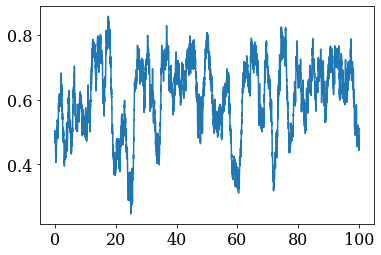

In [16]:
%%time 

time, trajectory = stochastic_integrate(f, 0.01, 10000, {'alpha': 0.6}, 0.5, 100, 0.1)

plt.plot(time, trajectory);

It seems to work !

### (vii) Fix $\alpha$ = 0.9. Determine the probability density function of the temperature variability, both in the (deterministically) subcritical (e.g. $\delta$ = 1) and supercritical case (e.g. $\delta$ = 2) for different values of σ.

Does a stochastic Hopf bifurcation occur at the transition from steady to oscillatory behavior?


***Solution:***

First we compute long trajectories of the subcritical case ($\delta = $ 1) for various $\sigma$:

In [17]:
%%time

sigma_vec = [0.005, 0.01,0.025, 0.05,0.1]
sub_trajectory = list()

for sigma in sigma_vec:

    sub_time, trajectory = stochastic_integrate(f, 0.01, 201000, {'alpha': 0.9}, 0.5, 100, sigma)
    sub_trajectory.append(trajectory)

# droping the first thousand steps (transient):
sub_time = sub_time[1000:]
for i in range(len(sub_trajectory)):
    sub_trajectory[i] = sub_trajectory[i][1000:]

CPU times: user 3.77 s, sys: 35.7 ms, total: 3.81 s
Wall time: 3.77 s


And we plot their distribution (histogram):

In [18]:
def plot_hist(x, y, ax, ax_histy, binwidth = 0.01, plot_kwargs=None, hist_kwargs=None):
    """Helper function to plot a trajectory and its histogram besides."""
    if plot_kwargs is None:
        plot_kwargs = dict()
        
    if hist_kwargs is None:
        hist_kwargs = dict()
    
    # no labels
    ax_histy.tick_params(axis="y", labelleft=False)

    # the scatter plot:
    ax.plot(x, y, **plot_kwargs)

    # now determine the bins:
    bins = np.arange(np.min(y), np.max(y) + binwidth, binwidth)
    ax_histy.hist(y, bins=bins, orientation='horizontal', **hist_kwargs)

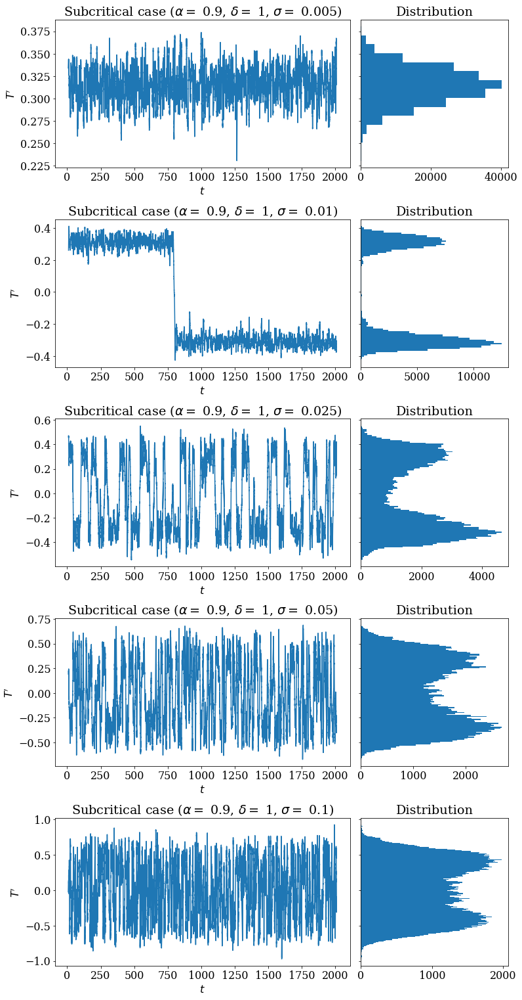

In [19]:
fig = plt.figure(figsize=(12, 5*len(sigma_vec)))

gs = fig.add_gridspec(len(sigma_vec), 2,  width_ratios=(4, 2),
                      left=0.1, right=0.9, bottom=0.1, top=0.9,
                      wspace=0.05, hspace=0.35)

for i, sigma in enumerate(sigma_vec):
    ax = fig.add_subplot(gs[i, 0])
    ax_histy = fig.add_subplot(gs[i, 1], sharey=ax)

    plot_hist(sub_time, sub_trajectory[i], ax, ax_histy)

    ax.set_title(r"Subcritical case ($\alpha =$ 0.9, $\delta =$ 1, $\sigma =$ "+str(sigma) + ")")
    ax.set_xlabel(r'$t$')
    ax.set_ylabel(r"$T'$")
    ax_histy.set_title('Distribution');

Then we compute a long trajectory of the supercritical case ($\delta =$ 2) for various $\sigma$:

In [20]:
%%time

sigma_vec = [0.005, 0.01,0.025, 0.05,0.1]
sup_trajectory = list()

for sigma in sigma_vec:

    sup_time, trajectory = stochastic_integrate(f, 0.01, 201000, {'alpha': 0.9}, 0.5, 200, sigma)
    sup_trajectory.append(trajectory)

# droping the first thousand steps (transient):
sup_time = sup_time[1000:]
for i in range(len(sup_trajectory)):
    sup_trajectory[i] = sup_trajectory[i][1000:]

CPU times: user 3.79 s, sys: 3.75 ms, total: 3.79 s
Wall time: 3.79 s


And we plot again their distribution (histogram):

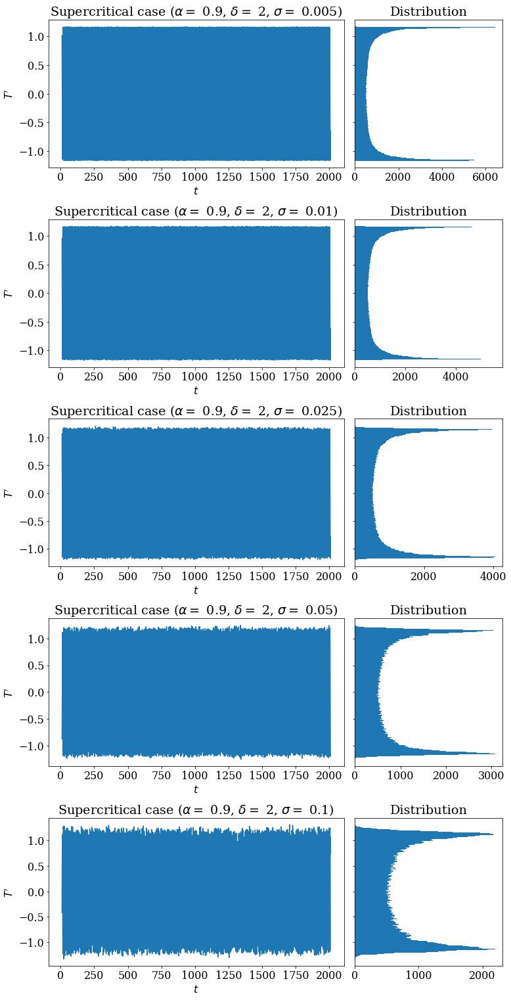

In [21]:
fig = plt.figure(figsize=(12, 5*len(sigma_vec)))

gs = fig.add_gridspec(len(sigma_vec), 2,  width_ratios=(4, 2),
                      left=0.1, right=0.9, bottom=0.1, top=0.9,
                      wspace=0.05, hspace=0.35)

for i, sigma in enumerate(sigma_vec):
    ax = fig.add_subplot(gs[i, 0])
    ax_histy = fig.add_subplot(gs[i, 1], sharey=ax)

    plot_hist(sup_time, sup_trajectory[i], ax, ax_histy)

    ax.set_title(r"Supercritical case ($\alpha =$ 0.9, $\delta =$ 2, $\sigma =$ "+str(sigma) + ")")
    ax.set_xlabel(r'$t$')
    ax.set_ylabel(r"$T'$")
    ax_histy.set_title('Distribution');

### *(viii)* What is the underlying dynamical mechanism (in a stochastic Hopf bifurcation) that noise excites an oscillatory mode under (deterministic) subcritical conditions?

***Solution:***

We see from the figures above that the noise is allowing the system to escape from a stable state to the other one, hence creating a sort of noisy periodic behavior before the deterministic transition occurs. The stationary probability density shifts from a Gaussian distribution (which tends to a Dirac distribution if $\sigma\to 0$) to a *crater*-like one with two modes.